In [494]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Loading the data
X_train = pd.read_csv('data/single_turbine_data/X_train.csv')
X_test = pd.read_csv('data/single_turbine_data/X_test.csv')
y_train = pd.read_csv('data/single_turbine_data/y_train.csv')
y_test = pd.read_csv('data/single_turbine_data/y_test.csv')

# convert to datetime
X_train['# Date and time'] = pd.to_datetime(X_train['# Date and time'])
X_test['# Date and time'] = pd.to_datetime(X_test['# Date and time'])
y_train['# Date and time'] = pd.to_datetime(y_train['# Date and time'])
y_test['# Date and time'] = pd.to_datetime(y_test['# Date and time'])

# Setting the index
# X_train.set_index('# Date and time', inplace=True)
# X_test.set_index('# Date and time', inplace=True)
# y_train.set_index('# Date and time', inplace=True)
# y_test.set_index('# Date and time', inplace=True)

# Merging X and y
train = pd.merge(X_train, y_train, on='# Date and time')
test = pd.merge(X_test, y_test, on='# Date and time')


In [495]:
train.isnull().sum()

# Date and time                                0
1_Wind speed (m/s)                             0
1_Wind direction (°)                           0
1_Nacelle position (°)                         0
1_Power (kW)                                   0
1_Reactive power (kvar)                        0
1_Front bearing temperature (°C)               0
1_Rear bearing temperature (°C)                0
1_Stator temperature 1 (°C)                    0
1_Nacelle ambient temperature (°C)             0
1_Nacelle temperature (°C)                     0
1_Transformer temperature (°C)                 0
1_Generator bearing rear temperature (°C)      0
1_Generator bearing front temperature (°C)     0
1_Temp. top box (°C)                           0
1_Hub temperature (°C)                         0
1_Ambient temperature (converter) (°C)         0
1_Rotor bearing temp (°C)                      0
1_Transformer cell temperature (°C)            0
1_Voltage L1 / U (V)                           0
1_Voltage L2 / V (V)

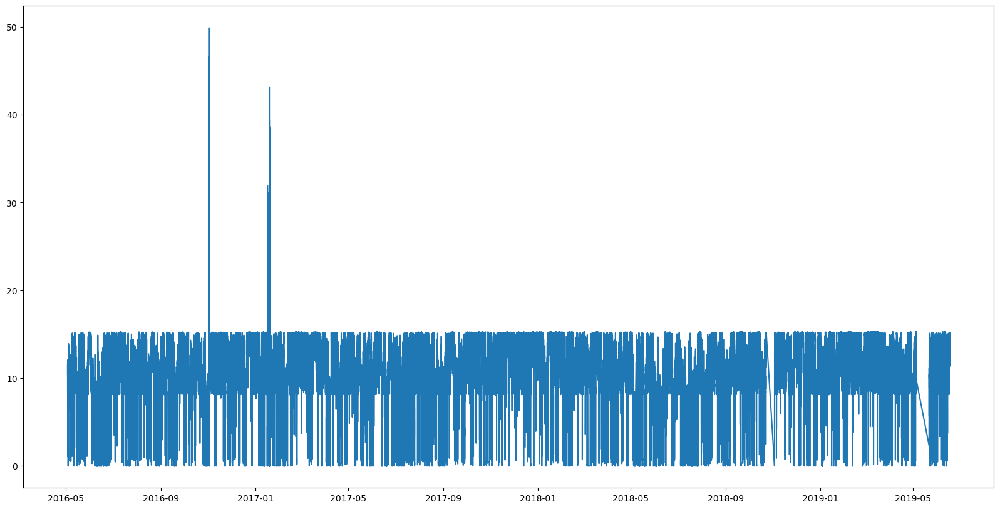

In [496]:
# plot rotor speed over time
plt.figure(figsize=(20, 10))
plt.plot(train['# Date and time'], train['1_Rotor speed (RPM)'])

In [497]:
# drop rotor speed
train.drop('1_Rotor speed (RPM)', axis=1, inplace=True)
test.drop('1_Rotor speed (RPM)', axis=1, inplace=True)

# drop columns containing voltage or pitch
train.drop(columns=[col for col in train.columns if 'Voltage' in col or 'pitch' in col], inplace=True)
test.drop(columns=[col for col in test.columns if 'Voltage' in col or 'pitch' in col], inplace=True)

# drop columns
train.drop(columns=['1_Current L1 / U (A)', '1_Current L2 / V (A)', '1_Current L3 / W (A)', '1_Apparent power (kVA)'], inplace=True)
test.drop(columns=['1_Current L1 / U (A)', '1_Current L2 / V (A)', '1_Current L3 / W (A)', '1_Apparent power (kVA)'], inplace=True)

train.drop(columns=['1_Gearbox speed (RPM)'], inplace=True)
test.drop(columns=['1_Gearbox speed (RPM)'], inplace=True)

train.drop(columns=['1_Yaw bearing angle (°)'], inplace=True)
test.drop(columns=['1_Yaw bearing angle (°)'], inplace=True)

train.drop(columns=['1_Reactive power (kvar)'], inplace=True)
test.drop(columns=['1_Reactive power (kvar)'], inplace=True)

In [498]:
# ffill the missing values
train.fillna(method='ffill', inplace=True)
test.fillna(method='ffill', inplace=True)

,1_Wind speed (m/s),1_Wind direction (°),1_Nacelle position (°),1_Power (kW),1_Front bearing temperature (°C),1_Rear bearing temperature (°C),1_Stator temperature 1 (°C),1_Nacelle ambient temperature (°C),1_Nacelle temperature (°C),1_Transformer temperature (°C),1_Generator bearing rear temperature (°C),1_Generator bearing front temperature (°C),1_Temp. top box (°C),1_Hub temperature (°C),1_Ambient temperature (converter) (°C),1_Rotor bearing temp (°C),1_Transformer cell temperature (°C),1_Generator RPM (RPM),1_Gear oil temperature (°C)
count,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000,158731.000000
mean,6.190610,203.206531,202.777021,604.836196,66.315199,64.465780,61.946185,11.853208,21.602188,47.432094,39.833930,39.584626,26.096581,20.254720,14.248443,29.529580,16.689330,1245.136611,53.157848
std,2.676158,92.362138,92.586422,597.372288,9.899463,8.277819,7.563627,5.926940,5.535526,18.224924,4.374203,5.521633,3.785337,4.811570,6.203600,3.871439,5.882131,467.858814,5.567609
min,0.110653,0.003519,0.011559,-16.652830,8.100000,7.900000,7.800000,-6.605000,0.263158,9.900000,6.700000,8.100000,9.480000,7.216842,-3.620000,5.000000,-1.460000,-580.038330,8.897500
25%,4.280668,144.544434,143.244003,125.539639,62.752499,63.606249,59.607502,7.435000,18.138487,35.634998,37.705555,37.005001,23.870001,16.498250,9.650000,27.295000,12.190000,986.373768,50.847500
50%,5.988556,223.053421,222.871735,396.225006,70.660004,67.150002,61.860001,11.607500,21.902500,41.830002,40.022499,40.627499,26.510000,20.000000,13.967500,29.757500,16.709999,1278.196289,54.162498
75%,7.788085,267.161362,267.228119,924.432253,72.867500,69.050003,64.092499,16.004999,25.379473,52.042500,42.282501,43.450001,28.562500,24.000000,18.430000,32.110001,20.895000,1640.483459,57.017502
max,24.376621,359.998779,359.982971,2081.028912,82.802498,75.967499,103.477501,33.522499,39.192501,110.752502,69.014999,73.837500,39.855000,37.000000,36.197502,41.314999,36.847500,1816.038086,60.982498


,1_Wind speed (m/s),1_Wind direction (°),1_Nacelle position (°),1_Power (kW),1_Front bearing temperature (°C),1_Rear bearing temperature (°C),1_Stator temperature 1 (°C),1_Nacelle ambient temperature (°C),1_Nacelle temperature (°C),1_Transformer temperature (°C),1_Generator bearing rear temperature (°C),1_Generator bearing front temperature (°C),1_Temp. top box (°C),1_Hub temperature (°C),1_Ambient temperature (converter) (°C),1_Rotor bearing temp (°C),1_Transformer cell temperature (°C),1_Generator RPM (RPM),1_Gear oil temperature (°C)
count,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.00000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000,52206.000000
mean,6.380529,195.298746,195.322123,680.686166,66.663400,64.672228,62.997566,11.932996,21.59186,50.632756,41.359550,39.570765,28.005989,20.251537,14.227028,30.548657,17.109938,1267.317770,53.190064
std,2.926871,90.432399,90.582304,660.450066,9.737833,8.183178,8.214831,5.742550,5.59793,20.788938,4.818063,5.605261,4.667178,4.586358,5.971934,3.588224,5.548684,486.535452,5.285111
min,0.134232,0.007310,0.029888,-17.846463,17.897500,17.799999,18.200001,0.577500,6.80000,24.547500,13.600000,17.200001,13.300000,11.900000,1.771053,13.495000,5.040000,-90.050355,18.740000
25%,4.270729,130.991592,131.608982,133.108273,63.672797,64.077500,59.795469,7.125000,17.73250,36.477500,38.582500,36.438125,25.307499,16.000000,9.432500,28.600000,12.608750,993.783737,50.810476
50%,6.072543,215.882760,215.683182,445.387698,71.079999,67.352500,62.202500,11.043472,21.87000,42.858750,40.905000,40.502501,28.495000,19.000000,13.426985,30.671054,16.880000,1323.473365,54.039999
75%,8.056127,256.694115,257.390106,1088.858338,72.927500,69.237498,64.535000,15.994582,25.56000,57.366249,43.550000,43.544444,31.110000,24.000000,18.237500,32.892501,21.021875,1706.374971,57.020000
max,22.419562,359.996088,359.944001,2077.179653,79.855000,76.015000,101.934212,36.720000,39.74500,111.410001,74.320004,70.064706,41.975000,37.000000,40.572500,43.980000,40.865000,1819.409071,60.110001


/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/2733686590.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_train = train.corr()
/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/2733686590.py:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_test = test.corr()


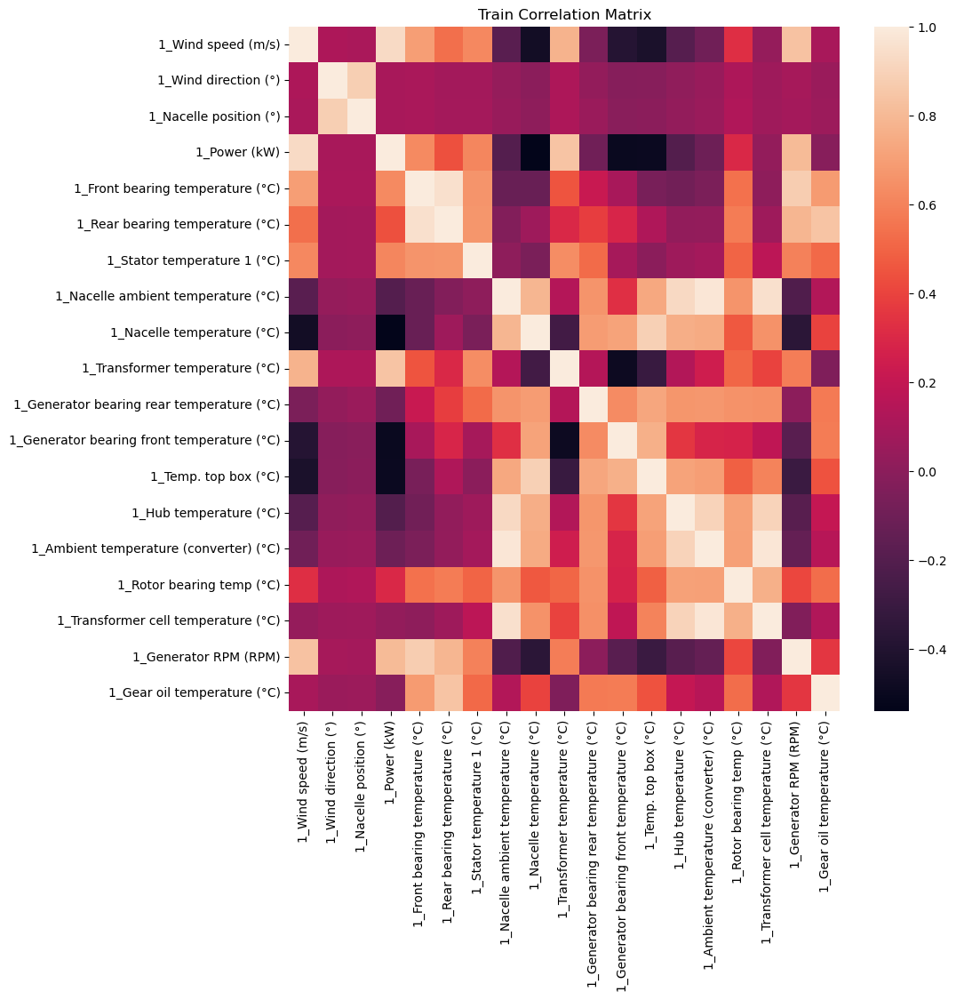

In [499]:
# Descriptive statistics
display(train.describe())
display(test.describe())

# Correlation analysis
corr_train = train.corr()
corr_test = test.corr()

# Heatmap of correlation matrix
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(corr_train, ax=ax)
plt.title('Train Correlation Matrix')
plt.show()

It looks like we have a strong correlation between some temperatures and also the pitch angles. Nacelle temperature does not correlate well, likely due to the fan cooling the nacelle.

The currents all correlate with one another and wind wind speed. Combine currents into one.

Rotor/gen/gbx speeds also correlates with current and wind speed but likely not as well due to downtimes. These then may contain useful downtime information. Could do 'if speed < value then generating = 0 else 1'.

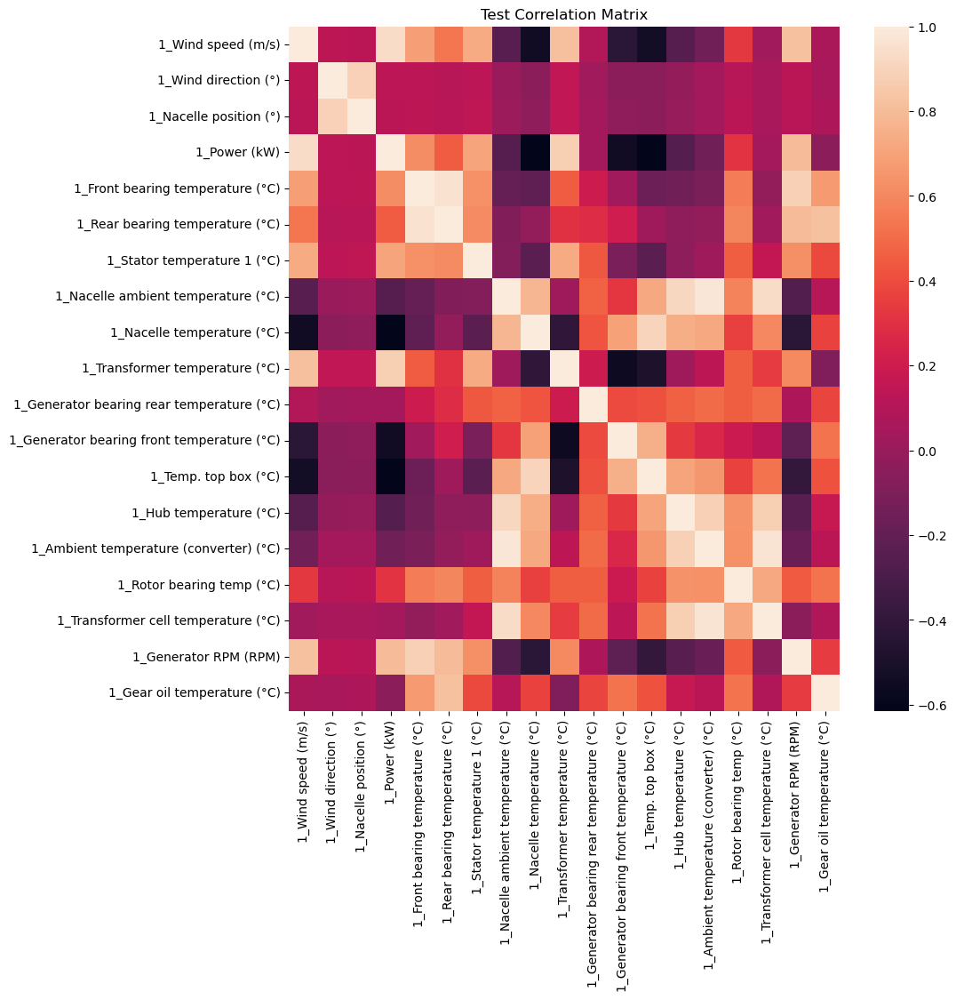

In [500]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(corr_test, ax=ax)
plt.title('Test Correlation Matrix')
plt.show()

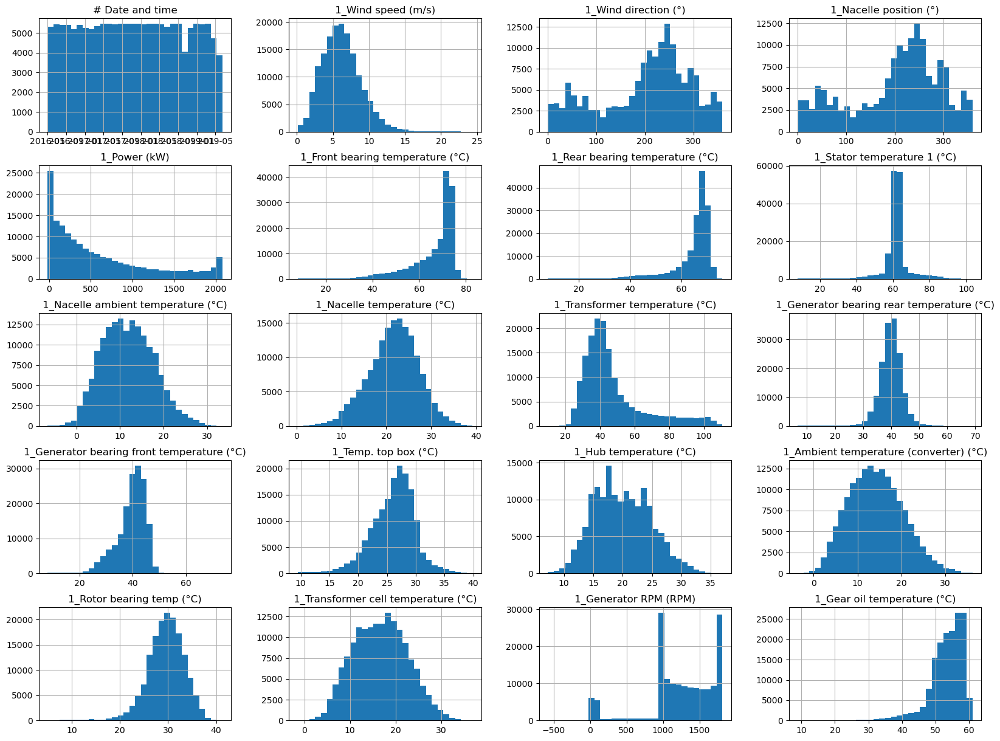

In [501]:
# Histograms for all variables in the dataframe
train.hist(bins=30, figsize=(20,15))
plt.show()

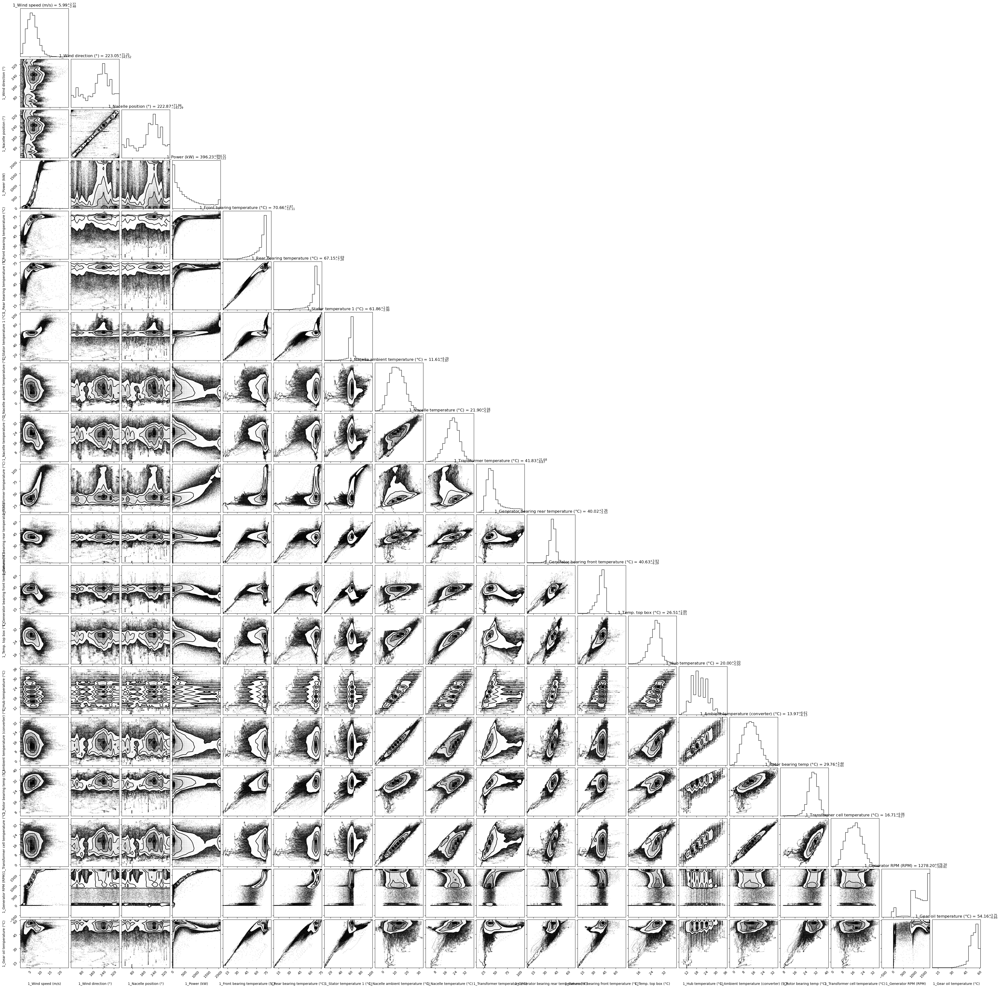

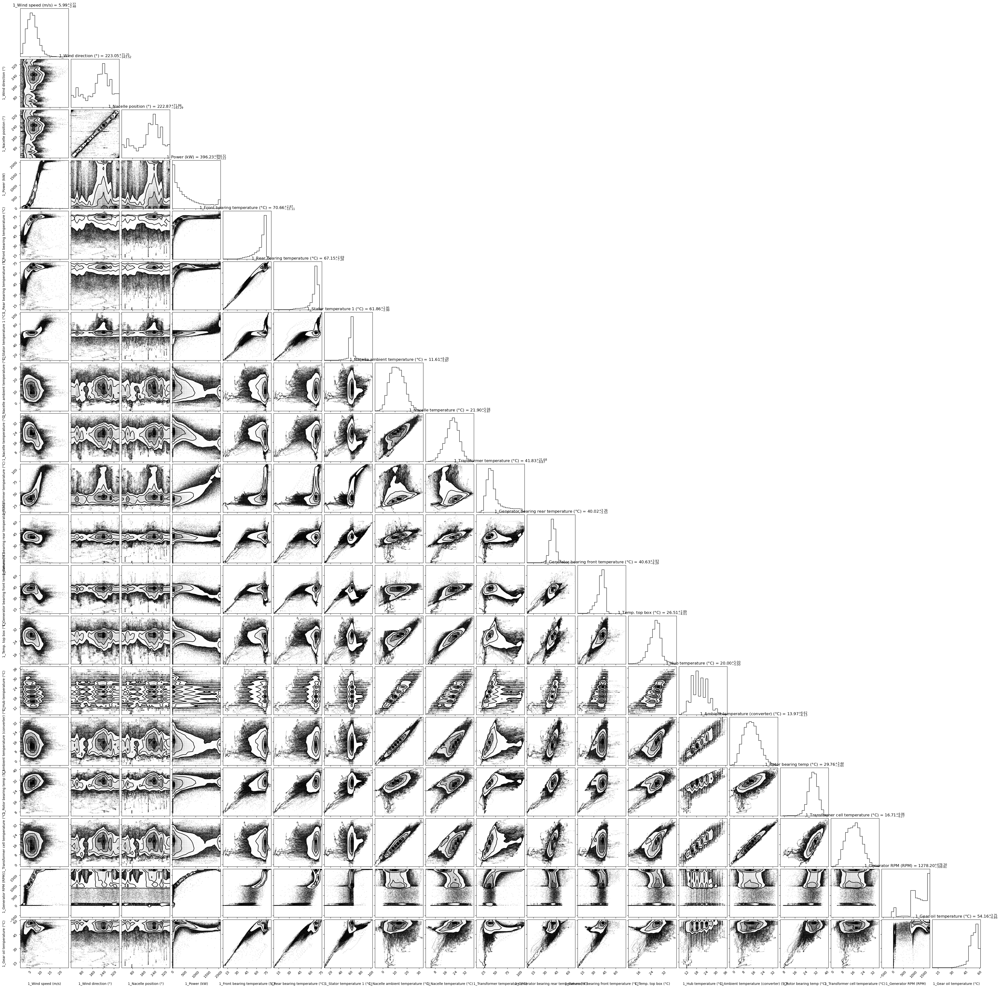

In [502]:
import corner

columns = [col for col in train.columns if col not in ['# Date and time']]

corner.corner(train[columns], labels=columns, show_titles=True, title_kwargs={"fontsize": 12})

We will want to drop everything in the zero active power bin. Or if we include it we may just need a bigger bodel.

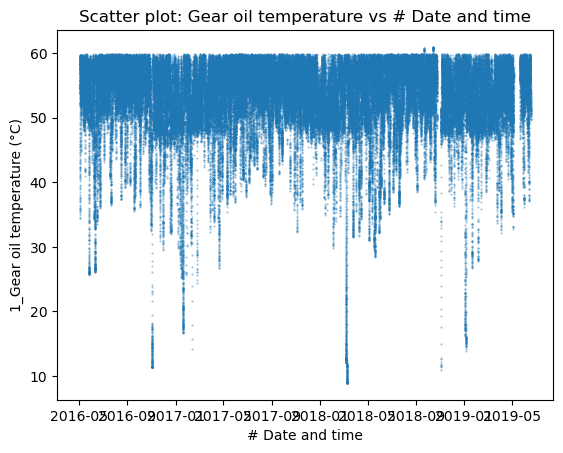

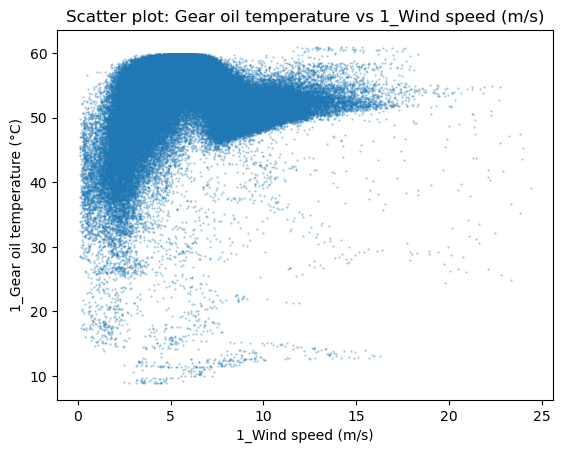

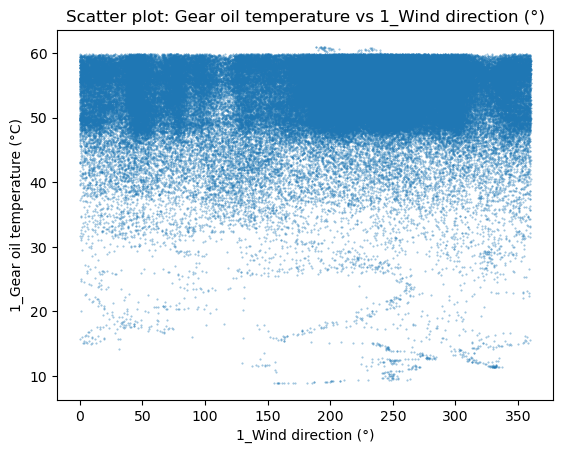

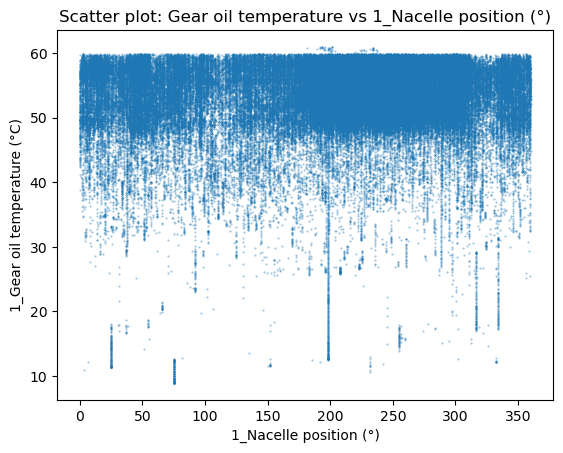

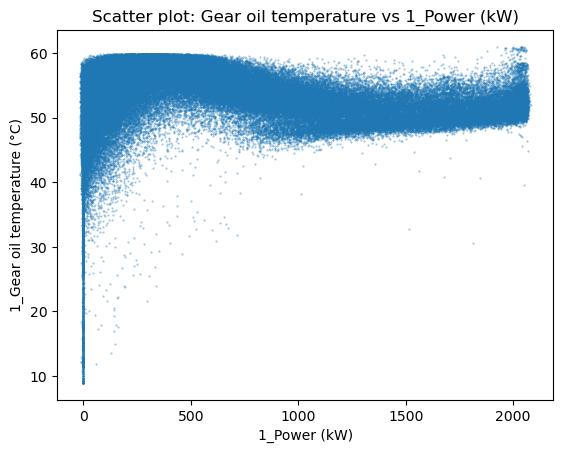

...

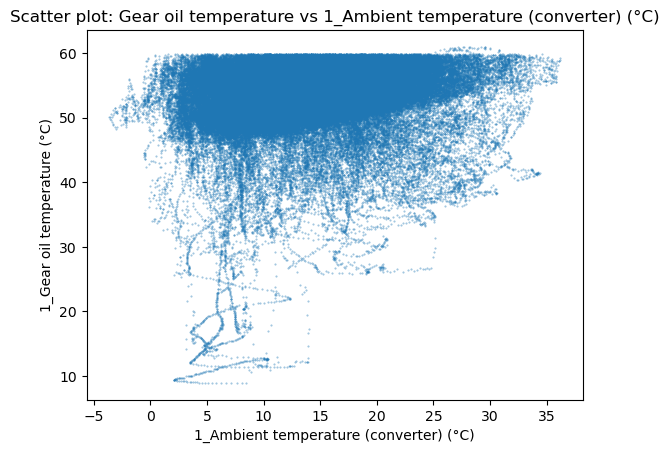

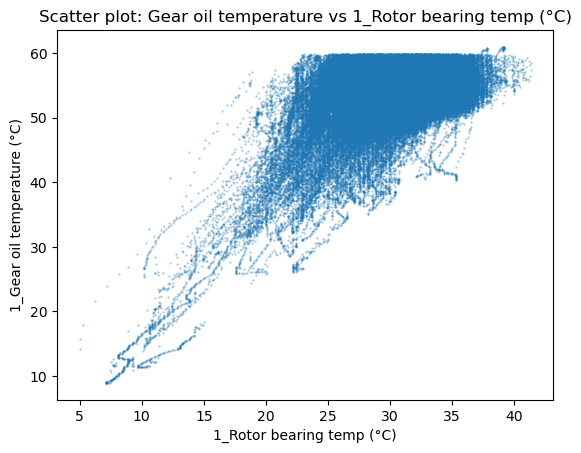

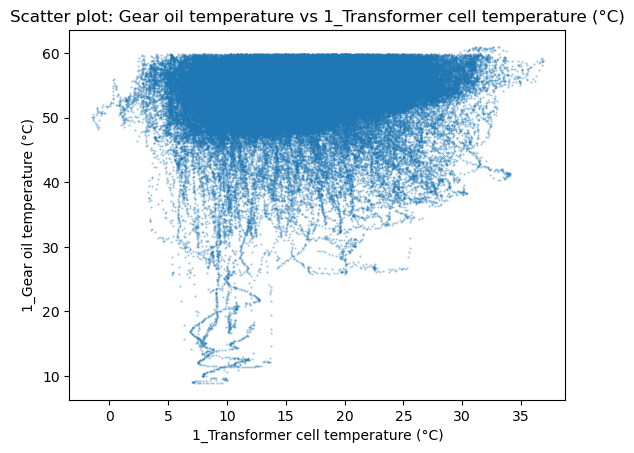

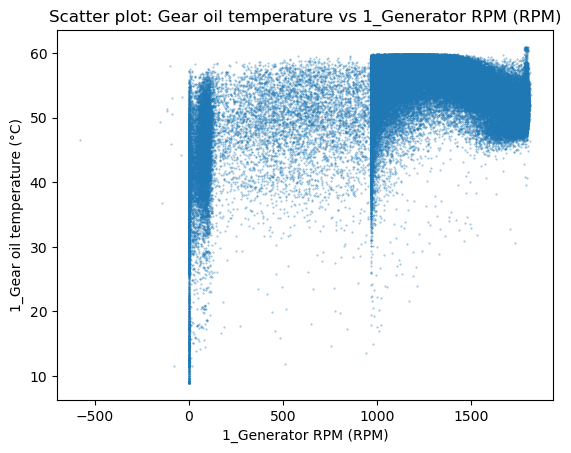

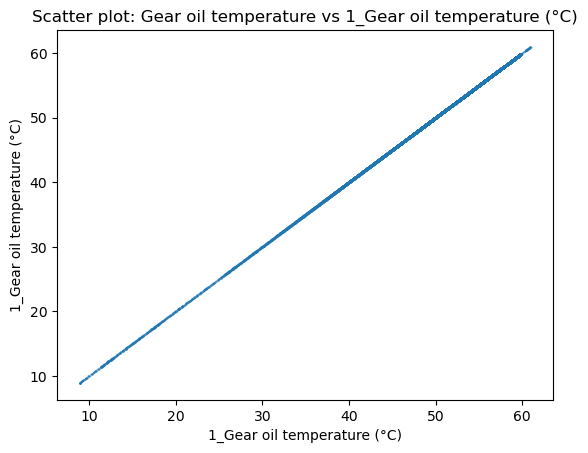

In [503]:
# Scatter plots of the target variable with respect to all other variables
for col in train.columns:
    train.plot(kind='scatter', x=col, y='1_Gear oil temperature (°C)', alpha=0.5, s=0.2)
    plt.title(f'Scatter plot: Gear oil temperature vs {col}')
    plt.show()

In [504]:
train['curtailed'] = (train['1_Wind speed (m/s)'] >= 11) & ((train['1_Generator RPM (RPM)'] >= 850) & (train['1_Generator RPM (RPM)'] <= 1100))
test['curtailed'] = (test['1_Wind speed (m/s)'] >= 11) & ((test['1_Generator RPM (RPM)'] >= 850) & (test['1_Generator RPM (RPM)'] <= 1100))

In [505]:
# train['offline'] = (train['1_Wind speed (m/s)'] >= 5) & (train['1_Generator RPM (RPM)'] <= 800)
# test['offline'] = (test['1_Wind speed (m/s)'] >= 5) & (test['1_Generator RPM (RPM)'] <= 800)
train['offline'] = train['1_Power (kW)'] <= 100
test['offline'] = test['1_Power (kW)'] <= 100

In [506]:
# drop '1_Wind speed (m/s)'
train.drop(['1_Wind speed (m/s)'], axis=1, inplace=True)
test.drop(['1_Wind speed (m/s)'], axis=1, inplace=True)

/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


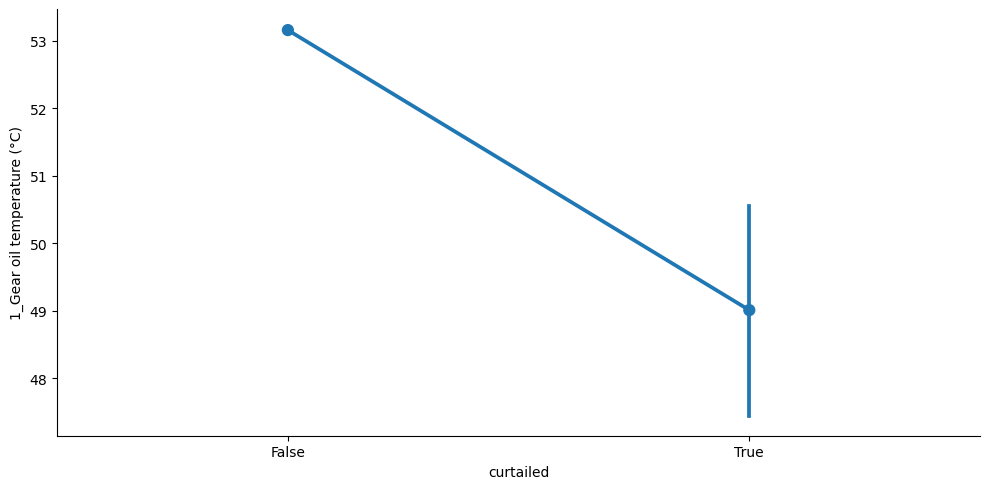

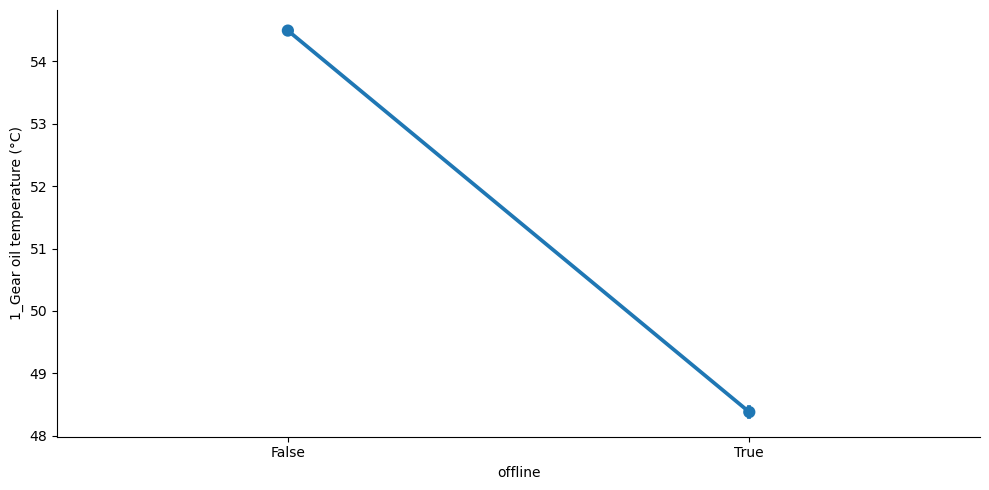

In [507]:
# Generate categorical plots for features
for col in ['curtailed', 'offline']:
    sns.catplot(x=col, y='1_Gear oil temperature (°C)', data=train, kind='point', aspect=2, )

In [508]:
def detect_outlier(feature):
    data = train[feature]
    mean = np.mean(data)
    std = np.std(data)

    z_scores = np.abs((data - mean) / std)
    outliers = data[z_scores > 3]

    cap_95 = data.quantile(.95)
    cap_99 = data.quantile(.99)
    cap_999 = data.quantile(.999)
    cap_3sd = mean + 3 * std
    cap_4sd = mean + 4 * std

    print('\nOutlier caps for {}:'.format(feature))
    print('  --95p: {:.1f} / {} values exceed that'.format(cap_95, (data > cap_95).sum()))
    print('  --3sd: {:.1f} / {} values exceed that'.format(cap_3sd, len(outliers)))
    print('  --4sd: {:.1f} / {} values exceed that'.format(cap_4sd, (data > cap_4sd).sum()))
    print('  --99p: {:.1f} / {} values exceed that'.format(cap_99, (data > cap_99).sum()))
    print('  --99.9p: {:.1f} / {} values exceed that'.format(cap_999, (data > cap_999).sum()))

In [509]:
import numpy as np

# Determine what the upperbound should be for continuous features
non_bool_feats = train.dtypes[train.dtypes != "bool"].index

for feat in non_bool_feats:
    detect_outlier(feat)


Outlier caps for # Date and time:
  --95p: .1f / 7937 values exceed that
  --3sd: .1f / 0 values exceed that
  --4sd: .1f / 0 values exceed that
  --99p: .1f / 1588 values exceed that
  --99.9p: .1f / 159 values exceed that

Outlier caps for 1_Wind direction (°):
  --95p: 337.1 / 7937 values exceed that
  --3sd: 480.3 / 0 values exceed that
  --4sd: 572.7 / 0 values exceed that
  --99p: 354.5 / 1588 values exceed that
  --99.9p: 359.4 / 159 values exceed that

Outlier caps for 1_Nacelle position (°):
  --95p: 336.4 / 7928 values exceed that
  --3sd: 480.5 / 0 values exceed that
  --4sd: 573.1 / 0 values exceed that
  --99p: 354.0 / 1539 values exceed that
  --99.9p: 359.5 / 146 values exceed that

Outlier caps for 1_Power (kW):
  --95p: 1936.1 / 7937 values exceed that
  --3sd: 2396.9 / 0 values exceed that
  --4sd: 2994.3 / 0 values exceed that
  --99p: 2051.3 / 1588 values exceed that
  --99.9p: 2064.8 / 159 values exceed that

Outlier caps for 1_Front bearing temperature (°C):
  --

In [510]:
feat = '1_Generator bearing front temperature (°C)'
mean = train[feat].mean()
std = train[feat].std()

upper_limit = mean + 4*std

train[feat] = train[feat].clip(upper=upper_limit)

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/118494903.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train['1_Gear oil temperature (°C)'] , fit=norm);



 mu = 53.16 and sigma = 5.57



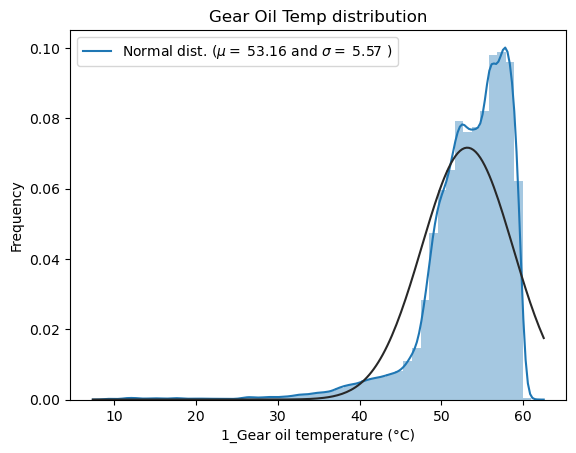

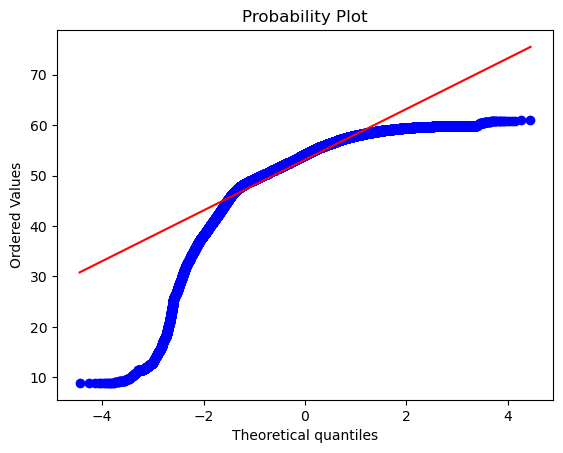

In [511]:
from scipy.stats import norm, skew
from scipy import stats

sns.distplot(train['1_Gear oil temperature (°C)'] , fit=norm);

# Get the fitted parameters used by the function
(mu, sigma) = norm.fit(train['1_Gear oil temperature (°C)'])
print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

#Now plot the distribution
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('Gear Oil Temp distribution')

#Get also the QQ-plot
fig = plt.figure()
res = stats.probplot(train['1_Gear oil temperature (°C)'], plot=plt)
plt.show()

/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/numpy/core/_methods.py:239: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/statsmodels/graphics/gofplots.py:910: RuntimeWarning: invalid value encountered in multiply
  ref_line = x * m + b


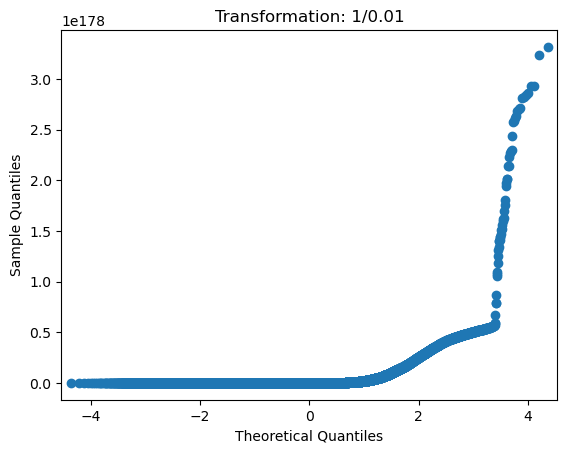

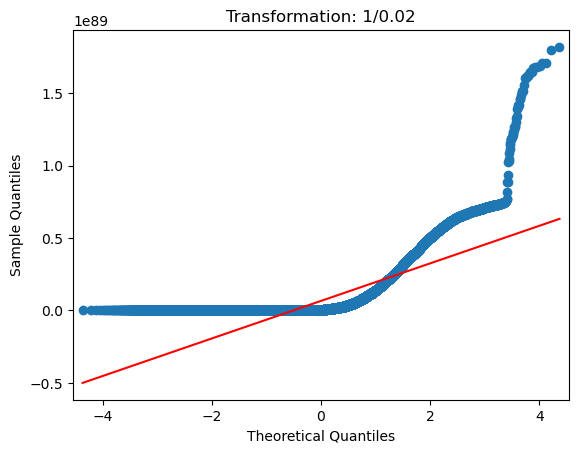

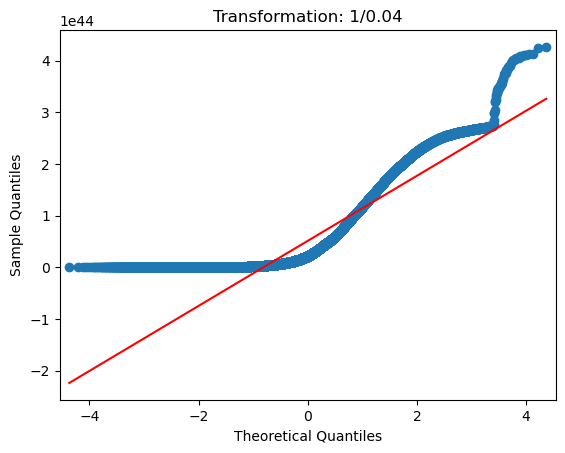

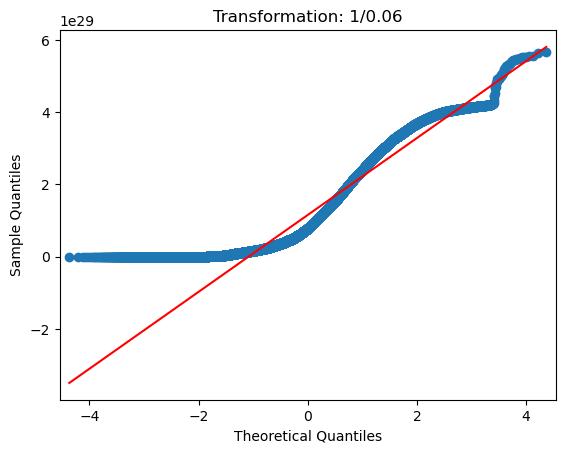

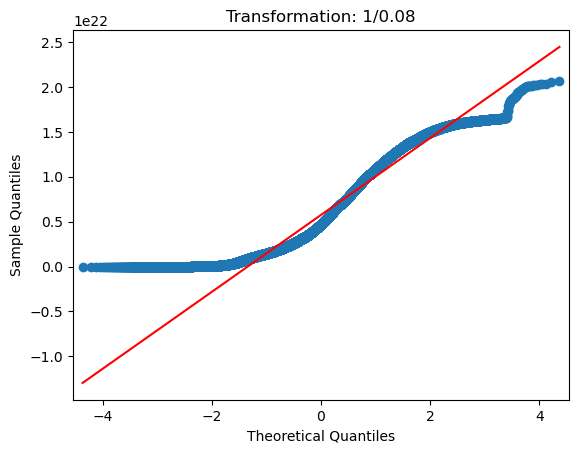

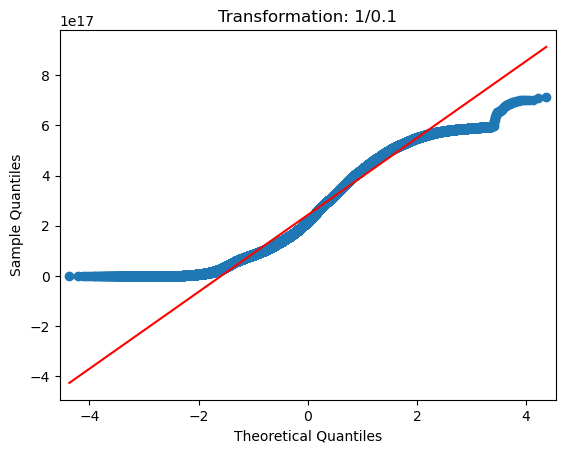

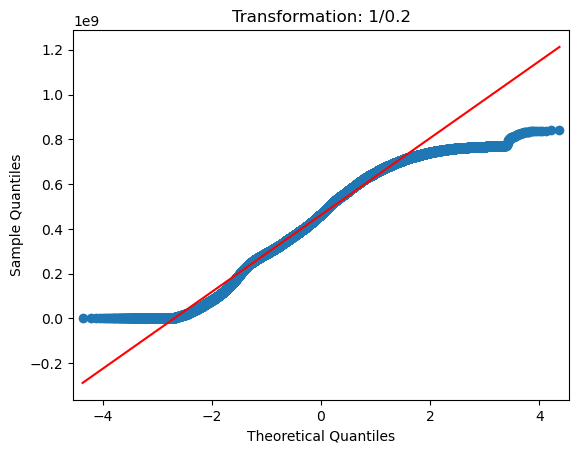

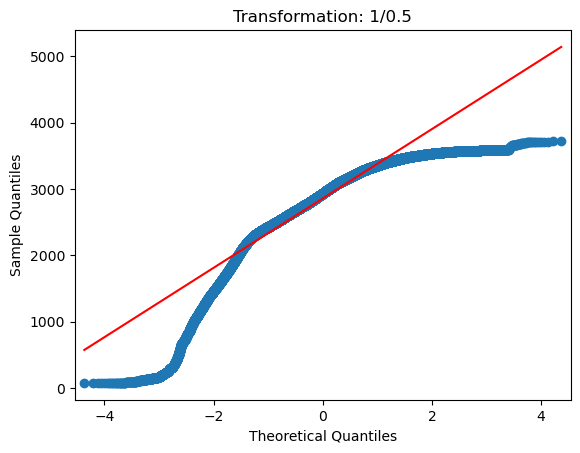

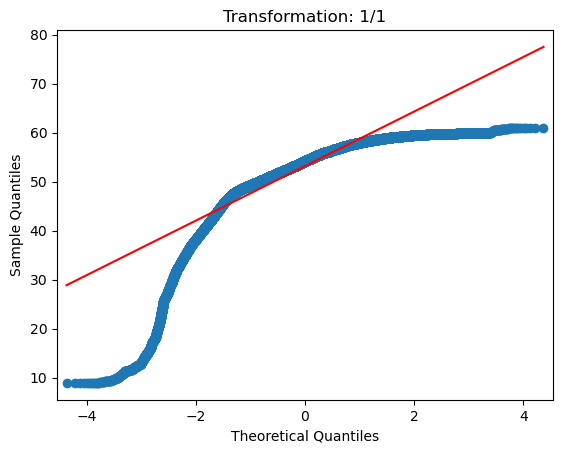

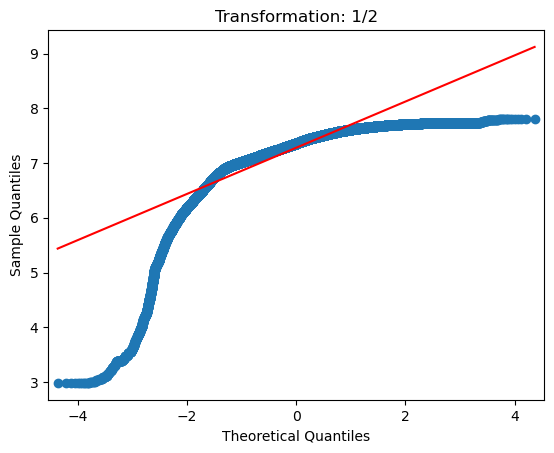

In [512]:
from statsmodels.graphics.gofplots import qqplot

# Generate QQ plots
for i in [0.01, 0.02, 0.04, 0.06, 0.08, 0.1, 0.2, 0.5, 1, 2]:
    data_t = train['1_Gear oil temperature (°C)']**(1/i)
    qqplot(data_t, line='s')
    plt.title("Transformation: 1/{}".format(str(i)))

In [513]:
# train['GearOilunsk'] = train['1_Gear oil temperature (°C)'].apply(lambda x: x**(1/0.06))
# test['GearOilunsk'] = test['1_Gear oil temperature (°C)'].apply(lambda x: x**(1/0.06))

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/3617996127.py:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)



 For base 2.718281828459045, mu = 3.98 and sigma = 0.13



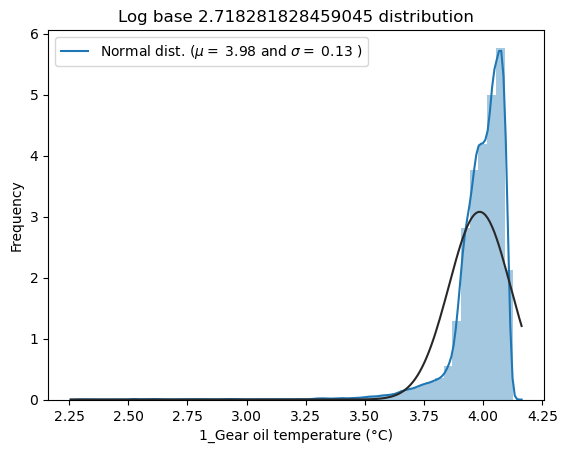

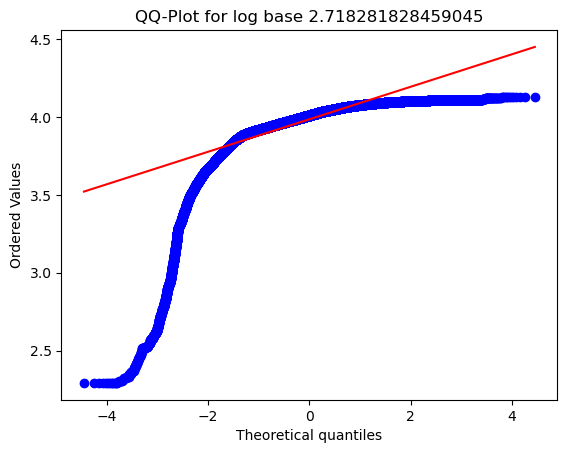

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/3617996127.py:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)



 For base 2, mu = 5.75 and sigma = 0.19



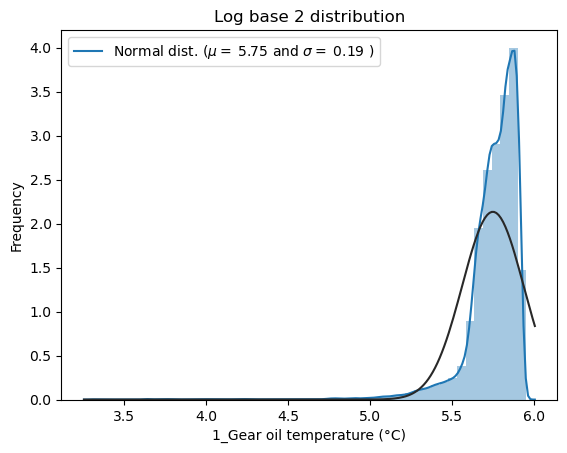

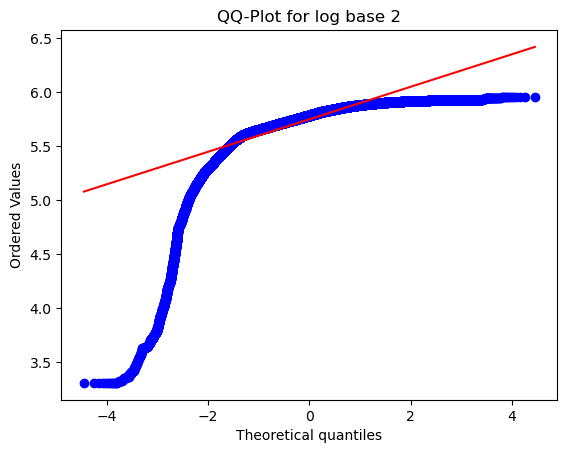


 For base 10, mu = 1.73 and sigma = 0.06



/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/3617996127.py:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)


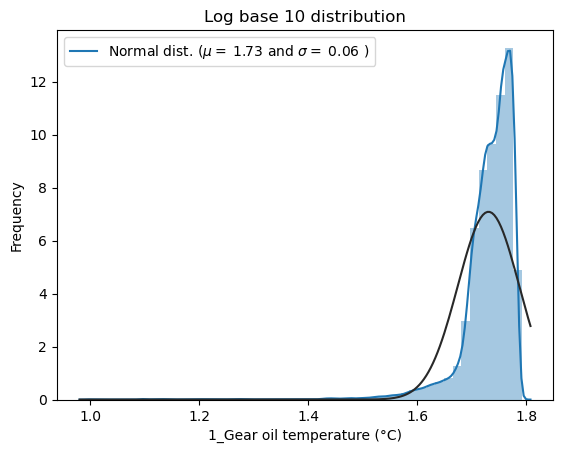

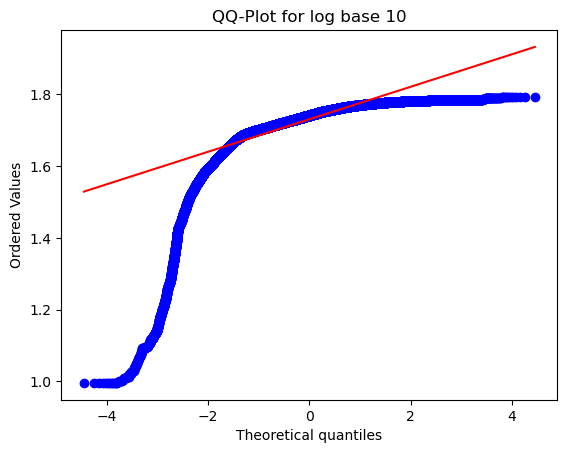

In [514]:
import matplotlib.pyplot as plt
from scipy.stats import norm, probplot
import seaborn as sns

def log_transform(base, series):
    # Apply logarithm with specified base to all elements of the series
    return np.log1p(series) / np.log(base)

# List of logarithm bases to test
log_bases = [np.e, 2, 10]

# Iterate over the logarithm bases
for base in log_bases:
    transformed = log_transform(base, train["1_Gear oil temperature (°C)"])
    
    # Check the new distribution 
    sns.distplot(transformed , fit=norm)
    plt.title(f'Log base {base} distribution')
    
    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(transformed)
    print(f'\n For base {base}, mu = {mu:.2f} and sigma = {sigma:.2f}\n')

    # Plot the distribution
    plt.legend([f'Normal dist. ($\mu=$ {mu:.2f} and $\sigma=$ {sigma:.2f} )'],
                loc='best')
    plt.ylabel('Frequency')
    plt.show()

    # Get also the QQ-plot
    fig = plt.figure()
    res = probplot(transformed, plot=plt)
    plt.title(f'QQ-Plot for log base {base}')
    plt.show()


In [515]:
train.dtypes

# Date and time                               datetime64[ns]
1_Wind direction (°)                                 float64
1_Nacelle position (°)                               float64
1_Power (kW)                                         float64
1_Front bearing temperature (°C)                     float64
1_Rear bearing temperature (°C)                      float64
1_Stator temperature 1 (°C)                          float64
1_Nacelle ambient temperature (°C)                   float64
1_Nacelle temperature (°C)                           float64
1_Transformer temperature (°C)                       float64
1_Generator bearing rear temperature (°C)            float64
1_Generator bearing front temperature (°C)           float64
1_Temp. top box (°C)                                 float64
1_Hub temperature (°C)                               float64
1_Ambient temperature (converter) (°C)               float64
1_Rotor bearing temp (°C)                            float64
1_Transformer cell tempe

In [516]:
# set the index
train.set_index('# Date and time', inplace=True)
test.set_index('# Date and time', inplace=True)

In [517]:
# train.drop(columns=['curtailed', 'offline', '1_Wind speed (m/s)'], inplace=True)
# test.drop(columns=['curtailed', 'offline', '1_Wind speed (m/s)'], inplace=True)

In [518]:
# For train DataFrame
for col in train.columns:
    if col not in ['curtailed', 'offline']:
        train.loc[train[col] <= 0, col] = 0.001

# For test DataFrame
for col in test.columns:
    if col not in ['curtailed', 'offline']:
        test.loc[test[col] <= 0, col] = 0.001

In [519]:
numeric_feats = train.dtypes[train.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats = train[numeric_feats].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness.head(30)


Skew in numerical features: 



,Skew
curtailed,132.792236
1_Transformer temperature (°C),1.493109
offline,1.361136
1_Power (kW),1.023387
1_Nacelle ambient temperature (°C),0.286869
1_Ambient temperature (converter) (°C),0.284949
1_Hub temperature (°C),0.251949
1_Transformer cell temperature (°C),0.104164
1_Nacelle temperature (°C),-0.245885
1_Temp. top box (°C),-0.507465


In [520]:
numeric_feats_test = test.dtypes[test.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats_test = test[numeric_feats].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness_test = pd.DataFrame({'Skew' :skewed_feats})
skewness_test.head(30)


Skew in numerical features: 



,Skew
curtailed,132.792236
1_Transformer temperature (°C),1.493109
offline,1.361136
1_Power (kW),1.023387
1_Nacelle ambient temperature (°C),0.286869
1_Ambient temperature (converter) (°C),0.284949
1_Hub temperature (°C),0.251949
1_Transformer cell temperature (°C),0.104164
1_Nacelle temperature (°C),-0.245885
1_Temp. top box (°C),-0.507465


In [521]:
skewness = skewness[abs(skewness) > 1.1]
skewness = skewness.dropna()
print("There are {} skewed numerical features to Box Cox transform".format(skewness.shape[0]))

from scipy.special import boxcox1p
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    if feat not in ['1_Gear oil temperature (°C)', 'GearOilunsk','curtailed', 'offline']:
    #all_data[feat] += 1
        train[f'{feat}unsk'] = boxcox1p(train[feat], lam)

There are 8 skewed numerical features to Box Cox transform


In [522]:
skewness_test = skewness_test[abs(skewness_test) > 1.1]
skewness_test = skewness_test.dropna()
print("There are {} skewed numerical features to Box Cox transform".format(skewness_test.shape[0]))

from scipy.special import boxcox1p
skewed_features_test = skewness_test.index
lam = 0.15
for feat in skewed_features_test:
    if feat not in ['1_Gear oil temperature (°C)', 'GearOilunsk','curtailed', 'offline']:
    #all_data[feat] += 1
        test[f'{feat}unsk'] = boxcox1p(test[feat], lam)

There are 8 skewed numerical features to Box Cox transform


In [523]:
print(train.shape, test.shape)
train = pd.get_dummies(train)
test = pd.get_dummies(test)
print(train.shape, test.shape)

(158731, 25) (52206, 25)
(158731, 25) (52206, 25)


In [524]:
def seasonality_features(df):
    df['month_sin'] = np.sin(2*np.pi*df.index.month/12)
    df['month_cos'] = np.cos(2*np.pi*df.index.month/12)
    df['hour_sin'] = np.sin(2*np.pi*df.index.hour/24)
    df['hour_cos'] = np.cos(2*np.pi*df.index.hour/24)
    return df

train = seasonality_features(train)
test = seasonality_features(test)

In [525]:
# save the data
train.to_csv('data/single_turbine_data/train_reduced_unskewed.csv', index=True)
test.to_csv('data/single_turbine_data/test_reduced_unskewed.csv', index=True)

In [526]:
all_data = train.append(test, ignore_index=False)
all_data = all_data[all_data['1_Power (kW)']<100]
all_data = all_data[:50]

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/313919314.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_data = train.append(test, ignore_index=False)


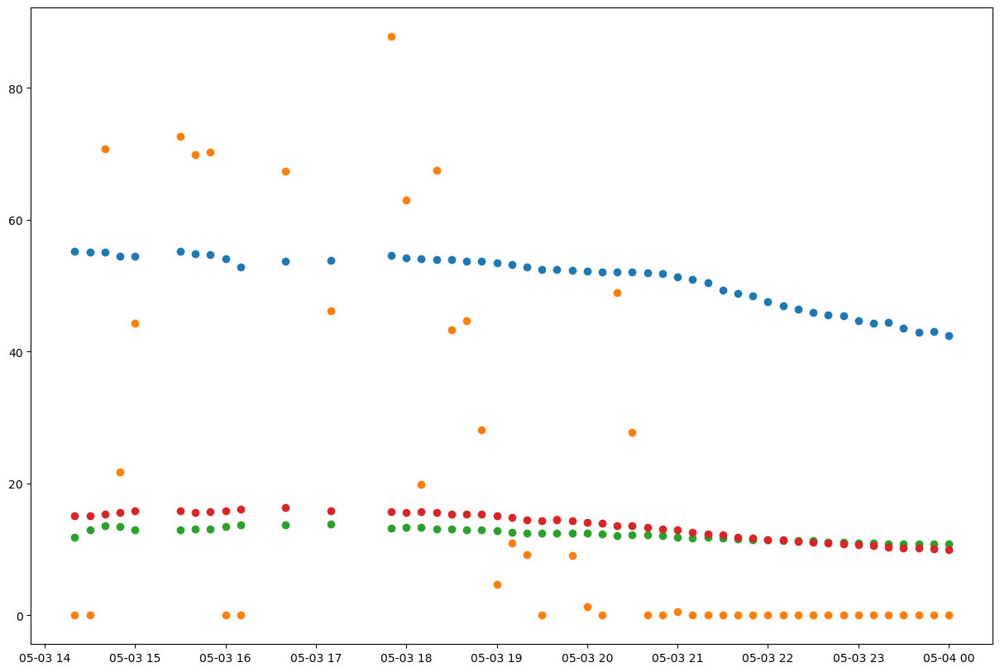

In [527]:
fig = plt.figure(figsize=(15, 10))

# plot the two time series
plt.scatter(all_data.index, all_data['1_Gear oil temperature (°C)'])
plt.scatter(all_data.index, all_data['1_Power (kW)'])
plt.scatter(all_data.index, all_data['1_Nacelle ambient temperature (°C)'])
plt.scatter(all_data.index, all_data['1_Ambient temperature (converter) (°C)'])

plt.show()

In [528]:
all_data.columns

Index(['1_Wind direction (°)', '1_Nacelle position (°)', '1_Power (kW)',
       '1_Front bearing temperature (°C)', '1_Rear bearing temperature (°C)',
       '1_Stator temperature 1 (°C)', '1_Nacelle ambient temperature (°C)',
       '1_Nacelle temperature (°C)', '1_Transformer temperature (°C)',
       '1_Generator bearing rear temperature (°C)',
       '1_Generator bearing front temperature (°C)', '1_Temp. top box (°C)',
       '1_Hub temperature (°C)', '1_Ambient temperature (converter) (°C)',
       '1_Rotor bearing temp (°C)', '1_Transformer cell temperature (°C)',
       '1_Generator RPM (RPM)', '1_Gear oil temperature (°C)', 'curtailed',
       'offline', '1_Transformer temperature (°C)unsk',
       '1_Generator bearing front temperature (°C)unsk',
       '1_Generator bearing rear temperature (°C)unsk',
       '1_Front bearing temperature (°C)unsk',
       '1_Rear bearing temperature (°C)unsk', 'month_sin', 'month_cos',
       'hour_sin', 'hour_cos'],
      dtype='object')

In [529]:
train.corr()['curtailed']

1_Wind direction (°)                              0.005296
1_Nacelle position (°)                            0.005206
1_Power (kW)                                      0.004001
1_Front bearing temperature (°C)                 -0.001537
1_Rear bearing temperature (°C)                  -0.005615
1_Stator temperature 1 (°C)                       0.019794
1_Nacelle ambient temperature (°C)               -0.003535
1_Nacelle temperature (°C)                       -0.007374
1_Transformer temperature (°C)                    0.018526
1_Generator bearing rear temperature (°C)         0.008037
1_Generator bearing front temperature (°C)       -0.008434
1_Temp. top box (°C)                             -0.009473
1_Hub temperature (°C)                           -0.005535
1_Ambient temperature (converter) (°C)           -0.001675
1_Rotor bearing temp (°C)                        -0.000895
1_Transformer cell temperature (°C)               0.001493
1_Generator RPM (RPM)                            -0.0041

<Axes: xlabel='1_Power (kW)', ylabel='1_Generator RPM (RPM)'>

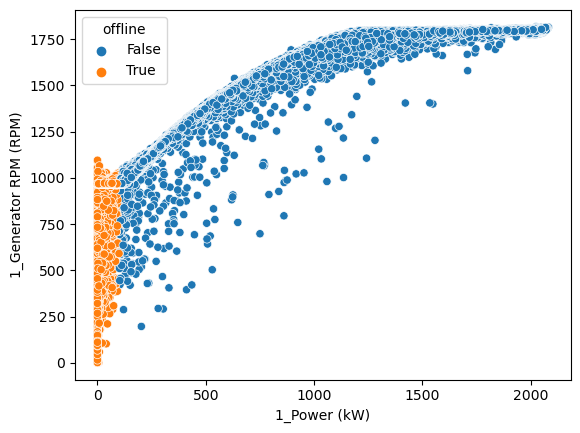

In [530]:
sns.scatterplot(data=train, x='1_Power (kW)', y='1_Generator RPM (RPM)', hue='offline')

In [531]:
all_data

,1_Wind direction (°),1_Nacelle position (°),1_Power (kW),1_Front bearing temperature (°C),1_Rear bearing temperature (°C),1_Stator temperature 1 (°C),1_Nacelle ambient temperature (°C),1_Nacelle temperature (°C),1_Transformer temperature (°C),1_Generator bearing rear temperature (°C),...,offline,1_Transformer temperature (°C)unsk,1_Generator bearing front temperature (°C)unsk,1_Generator bearing rear temperature (°C)unsk,1_Front bearing temperature (°C)unsk,1_Rear bearing temperature (°C)unsk,month_sin,month_cos,hour_sin,hour_cos
# Date and time,,,,,,,,,,,,,,,,,,,,,
2016-05-03 14:20:00,266.835754,267.316498,0.001000,61.095001,61.805000,60.759998,11.830,22.834999,38.555000,39.365002,...,True,4.907479,5.003928,4.942726,5.717513,5.738651,0.5,-0.866025,-0.500000,-8.660254e-01
2016-05-03 14:30:00,238.307297,240.706284,0.001000,58.570000,59.035000,61.630001,12.900,23.920000,38.154999,40.310001,...,True,4.889847,5.043125,4.983095,5.640636,5.654999,0.5,-0.866025,-0.500000,-8.660254e-01
2016-05-03 14:40:00,231.980743,245.317001,70.746277,59.150002,60.805000,61.224998,13.600,24.670000,37.895000,40.615002,...,True,4.878303,5.050302,4.995956,5.658537,5.708820,0.5,-0.866025,-0.500000,-8.660254e-01
2016-05-03 14:50:00,232.756042,242.487961,21.742624,57.494999,58.595001,61.875000,13.490,25.045000,37.630001,41.395000,...,True,4.866470,5.076949,5.028487,5.607063,5.641411,0.5,-0.866025,-0.500000,-8.660254e-01
2016-05-03 15:00:00,224.442139,239.167404,44.295727,58.139999,60.805000,61.820000,12.900,25.355000,37.294998,41.709999,...,True,4.851412,5.080785,5.041481,5.627269,5.708820,0.5,-0.866025,-0.707107,-7.071068e-01
2016-05-03 15:30:00,263.168427,260.683014,72.641113,62.139999,63.595001,64.754997,13.005,23.469999,36.880001,43.150002,...,True,4.832602,5.128250,5.099862,5.748554,5.791054,0.5,-0.866025,-0.707107,-7.071068e-01
2016-05-03 15:40:00,280.199890,260.683014,69.859268,59.950001,62.224998,62.529999,13.120,20.315001,36.685001,41.910000,...,True,4.823704,5.012911,5.049688,5.682988,5.751059,0.5,-0.866025,-0.707107,-7.071068e-01
2016-05-03 15:50:00,275.164764,260.683014,70.211510,59.685001,62.139999,59.764999,13.130,20.260000,36.584999,40.185001,...,True,4.819125,4.887632,4.977800,5.674919,5.748554,0.5,-0.866025,-0.707107,-7.071068e-01
2016-05-03 16:00:00,285.495605,263.785065,0.001000,57.299999,58.990002,59.040001,13.495,22.709999,36.415001,39.770000,...,True,4.811317,4.871837,4.960124,5.600917,5.653613,0.5,-0.866025,-0.866025,-5.000000e-01


/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/3118986722.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_data = train.append(test, ignore_index=False)


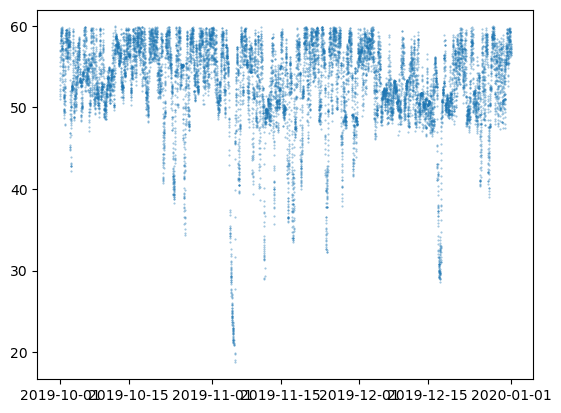

In [532]:
all_data = train.append(test, ignore_index=False)
event = all_data['2019-10-01':'2019-12-31']

plt.scatter(event.index, event['1_Gear oil temperature (°C)'], s=0.2, alpha=0.5)

In [1]:
import pandas as pd
from autogluon.tabular import TabularDataset, TabularPredictor
from sklearn.model_selection import train_test_split

train = pd.read_csv('data/single_turbine_data/train_reduced_unskewed.csv')
test = pd.read_csv('data/single_turbine_data/test_reduced_unskewed.csv')

label = ['1_Gear oil temperature (°C)']

# convert to datetime
train['# Date and time'] = pd.to_datetime(train['# Date and time'])

# Setting the index
train.set_index('# Date and time', inplace=True)

original_cols = ['1_Wind direction (°)',
       '1_Nacelle position (°)', '1_Power (kW)',
       '1_Front bearing temperature (°C)', '1_Rear bearing temperature (°C)',
       '1_Stator temperature 1 (°C)', '1_Nacelle ambient temperature (°C)',
       '1_Nacelle temperature (°C)', '1_Transformer temperature (°C)',
       '1_Generator bearing rear temperature (°C)',
       '1_Generator bearing front temperature (°C)', '1_Temp. top box (°C)',
       '1_Hub temperature (°C)', '1_Ambient temperature (converter) (°C)',
       '1_Rotor bearing temp (°C)', '1_Transformer cell temperature (°C)', '1_Generator RPM (RPM)']
          
train = train[original_cols + label]

In [2]:
# Lag by 1 to 6 steps and Lead by 1 to 6 steps
lag_dict = {}
lead_dict = {}

# Loop to create lagged and lead DataFrames for 1 to 6 steps
for i in range(1, 7):
    lag_df = train.copy()
    lag_df[label] = lag_df[label].shift(i)
    lag_df = lag_df.fillna(method='bfill')
    lag_df = lag_df.corr()
    lag_dict[f'lagged{i}'] = lag_df.loc[:, label]
    
    lead_df = train.copy()
    lead_df[label] = lead_df[label].shift(-i)
    lead_df = lead_df.fillna(method='ffill')
    lead_df = lead_df.corr()
    lead_dict[f'lead{i}'] = lead_df.loc[:, label]

# Original correlation
original = train.corr()
original_corr_with_label = original.loc[:, label]

# Concatenate all correlations into a single DataFrame
all_corr = pd.concat([original_corr_with_label] + list(lag_dict.values()) + list(lead_dict.values()), axis=1)
all_corr.columns = ['original'] + list(lag_dict.keys()) + list(lead_dict.keys())

best_lag_or_lead_dict = {}

for feature in all_corr.index:
    if feature != label[0]:  # skip the label itself
        best_corr_type = all_corr.loc[feature].idxmax()  # Gets the column name with max correlation
        
        # Translate column name to tuple (type, steps)
        if 'lagged' in best_corr_type:
            steps = int(best_corr_type.replace('lagged', ''))
            best_lag_or_lead_dict[feature] = ['lag', steps]
        elif 'lead' in best_corr_type:
            steps = int(best_corr_type.replace('lead', ''))
            best_lag_or_lead_dict[feature] = ['lead', steps]

print(best_lag_or_lead_dict)


{'1_Wind direction (°)': ['lead', 6], '1_Nacelle position (°)': ['lead', 3], '1_Power (kW)': ['lag', 6], '1_Stator temperature 1 (°C)': ['lag', 1], '1_Nacelle ambient temperature (°C)': ['lead', 6], '1_Transformer temperature (°C)': ['lead', 6], '1_Generator bearing rear temperature (°C)': ['lag', 1], '1_Temp. top box (°C)': ['lag', 1], '1_Hub temperature (°C)': ['lead', 6], '1_Ambient temperature (converter) (°C)': ['lead', 6], '1_Transformer cell temperature (°C)': ['lead', 6], '1_Generator RPM (RPM)': ['lead', 6]}


In [3]:
all_corr

,original,lagged1,lagged2,lagged3,lagged4,lagged5,lagged6,lead1,lead2,lead3,lead4,lead5,lead6
1_Wind direction (°),0.051447,0.050988,0.050636,0.050317,0.049969,0.049411,0.049182,0.051968,0.052377,0.052658,0.052857,0.052898,0.052940
1_Nacelle position (°),0.060928,0.060844,0.060823,0.061017,0.061121,0.061221,0.061318,0.061403,0.061606,0.061650,0.061646,0.061433,0.061314
1_Power (kW),-0.016071,-0.013228,-0.011310,-0.009746,-0.008628,-0.007589,-0.006863,-0.027088,-0.024790,-0.021835,-0.019052,-0.015862,-0.012798
1_Front bearing temperature (°C),0.685337,0.669450,0.656394,0.647043,0.637364,0.627805,0.618060,0.677321,0.675945,0.676301,0.675242,0.673536,0.670951
1_Rear bearing temperature (°C),0.843274,0.822392,0.805134,0.792186,0.779048,0.766361,0.753648,0.832856,0.828725,0.826632,0.823055,0.819034,0.814242
1_Stator temperature 1 (°C),0.515677,0.520088,0.518518,0.514752,0.510034,0.504913,0.499491,0.507861,0.503459,0.499308,0.495527,0.491862,0.488210
1_Nacelle ambient temperature (°C),0.140482,0.139662,0.139088,0.138659,0.138311,0.137995,0.137680,0.141038,0.141537,0.142326,0.143208,0.144142,0.145134
1_Nacelle temperature (°C),0.397021,0.373253,0.358335,0.350246,0.343486,0.337544,0.331783,0.392175,0.386036,0.383789,0.380420,0.377137,0.373698
1_Transformer temperature (°C),-0.040964,-0.041770,-0.042174,-0.042232,-0.042012,-0.041582,-0.040971,-0.039197,-0.036609,-0.033878,-0.030997,-0.028062,-0.025103
1_Generator bearing rear temperature (°C),0.569479,0.571595,0.568266,0.563721,0.558759,0.553638,0.548322,0.563106,0.558346,0.553750,0.549137,0.544508,0.539875


In [8]:
train = pd.read_csv('data/single_turbine_data/train_reduced_unskewed.csv')
test = pd.read_csv('data/single_turbine_data/test_reduced_unskewed.csv')

# Initialize new DataFrames to store extra features
train_extra_features = pd.DataFrame(index=train.index)
test_extra_features = pd.DataFrame(index=test.index)

# Create the best extra features based on best_lag_or_lead_dict
for feature, (corr_type, steps) in best_lag_or_lead_dict.items():
    new_column_name = f"{feature}_{corr_type}{steps}"
    
    if corr_type == 'lag':
        train_extra_features[new_column_name] = train[feature].shift(steps)
        test_extra_features[new_column_name] = test[feature].shift(steps)
        train_extra_features[new_column_name] = train_extra_features[new_column_name].fillna(method='bfill')
        test_extra_features[new_column_name] = test_extra_features[new_column_name].fillna(method='bfill')
    elif corr_type == 'lead':
        train_extra_features[new_column_name] = train[feature].shift(-steps)
        test_extra_features[new_column_name] = test[feature].shift(-steps)
        train_extra_features[new_column_name] = train_extra_features[new_column_name].fillna(method='ffill')
        test_extra_features[new_column_name] = test_extra_features[new_column_name].fillna(method='ffill')

# Drop rows with NaN values generated due to shifting
# train_extra_features.dropna(inplace=True)
# test_extra_features.dropna(inplace=True)

# Optionally concatenate these extra features back to the original train and test DataFrames
train = pd.concat([train.loc[train_extra_features.index], train_extra_features], axis=1)
test = pd.concat([test.loc[test_extra_features.index], test_extra_features], axis=1)

# save the data
train.to_csv('data/single_turbine_data/train_reduced_unskewed_extra.csv', index=True)
test.to_csv('data/single_turbine_data/test_reduced_unskewed_extra.csv', index=True)

In [10]:
import pandas as pd

era = pd.read_csv('data/single_turbine_data_notemp/ERA5T.csv')
X_train = pd.read_csv('data/single_turbine_data_notemp/X_train.csv')
y_train = pd.read_csv('data/single_turbine_data_notemp/y_train.csv')
train = pd.merge(X_train, y_train, on='# Date and time')
train.set_index('# Date and time', inplace=True)
train.index = pd.to_datetime(train.index)
era['datetime_start_utc'] = pd.to_datetime(era['datetime_start_utc'])
era['datetime_start_utc'] = era['datetime_start_utc'].dt.tz_convert(None)
era.set_index('datetime_start_utc', inplace=True)
# merge era and train and interpolate the missing values
# Resample and interpolate the ERA5T dataframe
era = era.resample('10T').asfreq()
era = era.interpolate(method='linear')
train = pd.merge(train, era, left_on=train.index, right_on=era.index).set_index('key_0')

DatetimeIndex(['2016-05-03 09:40:00', '2016-05-03 09:50:00',
               '2016-05-03 10:00:00', '2016-05-03 10:10:00',
               '2016-05-03 10:20:00', '2016-05-03 10:30:00',
               '2016-05-03 10:40:00', '2016-05-03 10:50:00',
               '2016-05-03 11:00:00', '2016-05-03 11:10:00',
               ...
               '2019-06-17 06:40:00', '2019-06-17 06:50:00',
               '2019-06-17 07:00:00', '2019-06-17 07:10:00',
               '2019-06-17 07:20:00', '2019-06-17 07:30:00',
               '2019-06-17 07:40:00', '2019-06-17 07:50:00',
               '2019-06-17 08:00:00', '2019-06-17 08:10:00'],
              dtype='datetime64[ns]', name='key_0', length=158731, freq=None)

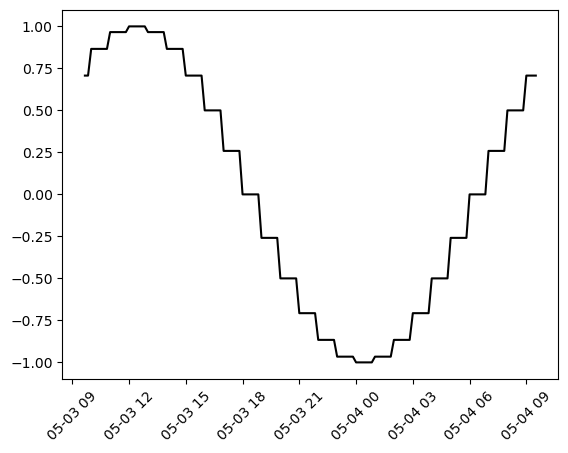

In [21]:
train.columns

import numpy as np

train['cos_wd'] = np.cos(2*np.pi*train['1_Wind direction (°)']/360)
train['cos_np'] = np.cos(2*np.pi*train['1_Nacelle position (°)']/360)
train['avg_dir'] = (train['cos_wd'] + train['cos_np'])/2

import matplotlib.pyplot as plt

# plt.scatter(train['cos_wd'], train['1_Gear oil temperature (°C)'], s=0.2, alpha=0.5)

def seasonality_features(df):
    df['month_sin'] = np.sin(2*np.pi*df.index.month/12)
    df['month_cos'] = np.cos(2*np.pi*df.index.month/12)*-1
    df['hour_sin'] = np.sin(2*np.pi*df.index.hour/24)
    df['hour_cos'] = np.cos(2*np.pi*df.index.hour/24)*-1
    return df

train = seasonality_features(train)

plt.plot(train.index[0:144], train['hour_cos'][0:144], color='black')
# tilt the ticks
plt.xticks(rotation=45)

train.index

In [26]:
# merge era and train


/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_99980/1973859169.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlations = train.corr()


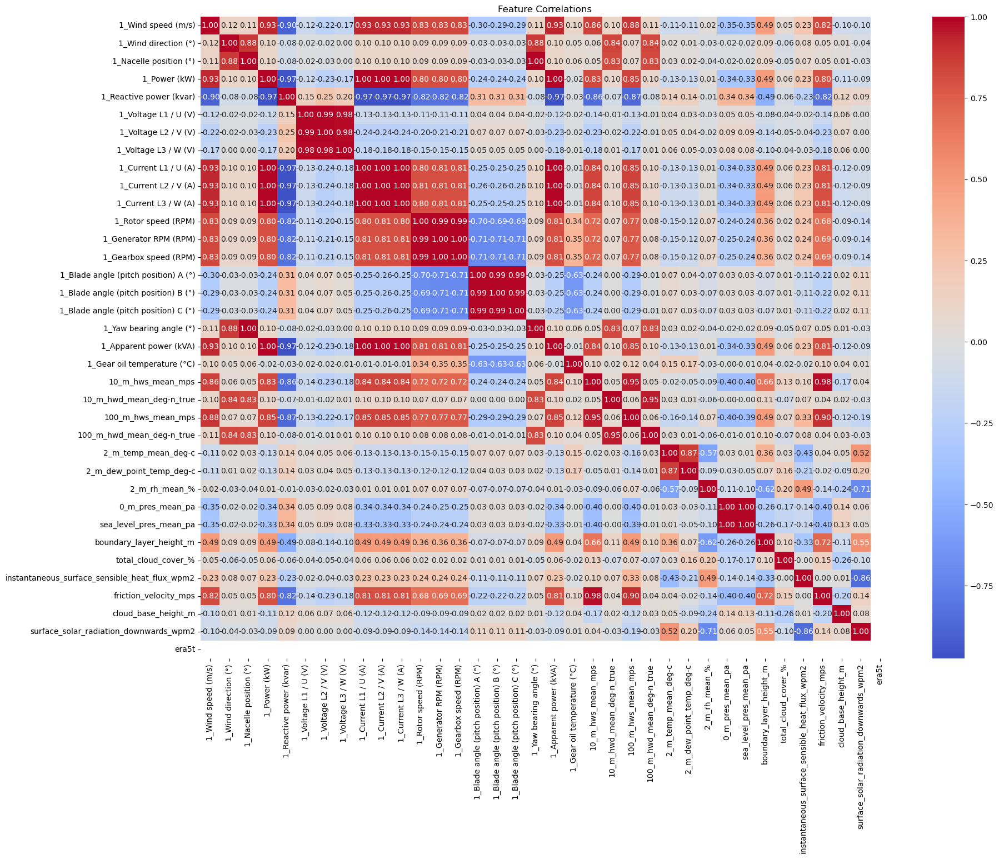

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns

# Compute correlations

correlations = train.corr()

# Plot heatmap

plt.figure(figsize=(20, 15))

sns.heatmap(correlations, annot=True, fmt=".2f", cmap="coolwarm", center=0)

plt.title('Feature Correlations')

plt.show()

In [32]:
train.columns

Index(['key_0', '1_Wind speed (m/s)', '1_Wind direction (°)',
       '1_Nacelle position (°)', '1_Power (kW)', '1_Reactive power (kvar)',
       '1_Voltage L1 / U (V)', '1_Voltage L2 / V (V)', '1_Voltage L3 / W (V)',
       '1_Current L1 / U (A)', '1_Current L2 / V (A)', '1_Current L3 / W (A)',
       '1_Rotor speed (RPM)', '1_Generator RPM (RPM)', '1_Gearbox speed (RPM)',
       '1_Blade angle (pitch position) A (°)',
       '1_Blade angle (pitch position) B (°)',
       '1_Blade angle (pitch position) C (°)', '1_Yaw bearing angle (°)',
       '1_Apparent power (kVA)', '1_Gear oil temperature (°C)',
       '10_m_hws_mean_mps', '10_m_hwd_mean_deg-n_true', '100_m_hws_mean_mps',
       '100_m_hwd_mean_deg-n_true', '2_m_temp_mean_deg-c',
       '2_m_dew_point_temp_deg-c', '2_m_rh_mean_%', '0_m_pres_mean_pa',
       'sea_level_pres_mean_pa', 'boundary_layer_height_m',
       'total_cloud_cover_%', 'instantaneous_surface_sensible_heat_flux_wpm2',
       'friction_velocity_mps', 'cloud_base_